# **COVID 19 Indonesia Geospatial - Tugas 9 Visualisasi Data** 

- Nama : Kurniadi Ahmad Wijaya
- NIM : 1301194024
- Kelas : IF-42-GAB06 / IF-43-09

In [38]:
import requests
import imageio
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import datetime
import pathlib

from IPython.display import Image
from matplotlib import cm
from tqdm import tqdm

import warnings
warnings.filterwarnings('ignore')

## **Inisialisasi Visual Geospasial Batas Provinsi Indonesia**

In [39]:
indonesia = gpd.read_file("geoindo/Batas Provinsi.shp")
indonesia.head()

,No,Kode_Prov,Provinsi,geometry
0,11.0,52,NUSA TENGGARA BARAT,"MULTIPOLYGON (((118.72881 -8.35901, 118.72886 ..."
1,22.0,53,NUSA TENGGARA TIMUR,"MULTIPOLYGON (((122.65419 -8.63712, 122.62966 ..."
2,25.0,63,KALIMANTAN SELATAN,"MULTIPOLYGON (((114.88632 -2.50353, 114.91290 ..."
3,27.0,65,KALIMANTAN UTARA,"MULTIPOLYGON (((116.58930 4.37422, 116.61513 4..."
4,30.0,76,SULAWESI BARAT,"MULTIPOLYGON (((119.86380 -1.96121, 119.87027 ..."


<AxesSubplot:>

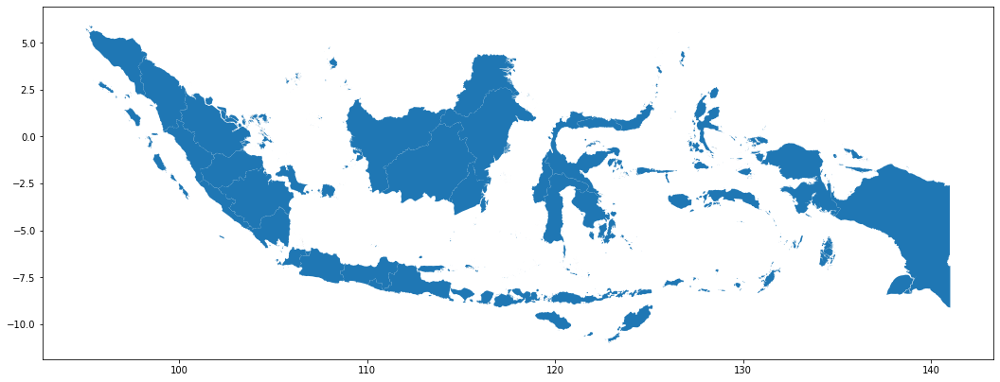

In [40]:
indonesia.plot(figsize=(18, 16))

## **Melakukan Pengambilan Data Kasus Harian COVID-19  Setiap Provinsi Terkini**

In [41]:
province = list(indonesia['Provinsi'])

province_u = lambda x: x.replace(' ', '_')
province_u = list(map(province_u, province))

In [42]:
dataset_pure = []

for i in tqdm(range(len(province))):
    response = requests.get(f'https://data.covid19.go.id/public/api/prov_detail_{province_u[i]}.json')
    response = response.json().get('list_perkembangan')

    dataset_pure.append([province[i], response])

100%|██████████| 34/34 [00:34<00:00,  1.00s/it]


### **Konversi Data JSON Menjadi Dataframe**

In [43]:
dataset = dataset_pure.copy()
df_list = []

for i in range(len(dataset)):
    for j in range(len(dataset[i][1])): 
        dataset[i][1][j]['PROVINSI'] = dataset[i][0]

    df_list.append(pd.DataFrame(dataset[i][1]))    

df = pd.concat(df_list)

In [44]:
def convert_timestamp(time):
    return datetime.datetime.fromtimestamp(time / 1000).date()

df['tanggal'] = df['tanggal'].apply(convert_timestamp)

start = pd.to_datetime("2021-05-01")
end = pd.Timestamp('today').date()

df = df.loc[(df['tanggal'] >= start) & (df['tanggal'] <= end)]
df.tail(5)


,tanggal,KASUS,MENINGGAL,SEMBUH,DIRAWAT_OR_ISOLASI,AKUMULASI_KASUS,AKUMULASI_SEMBUH,AKUMULASI_MENINGGAL,AKUMULASI_DIRAWAT_OR_ISOLASI,PROVINSI
628,2021-11-28,0,0,0,0,20157,19582,527,48,SULAWESI TENGGARA
629,2021-11-29,0,0,0,0,20157,19582,527,48,SULAWESI TENGGARA
630,2021-11-30,0,0,1,-1,20157,19583,527,47,SULAWESI TENGGARA
631,2021-12-01,0,0,1,-1,20157,19584,527,46,SULAWESI TENGGARA
632,2021-12-02,3,0,0,3,20160,19584,527,49,SULAWESI TENGGARA


## **Melakukan Penggabungan Dataset Geospasial Dan Kasus COVID-19 Untuk Setiap Provinsi**

In [45]:
df_covid_indonesia = indonesia.set_index('Provinsi').join(df.set_index('PROVINSI'))
df_covid_indonesia.head()

,No,Kode_Prov,geometry,tanggal,KASUS,MENINGGAL,SEMBUH,DIRAWAT_OR_ISOLASI,AKUMULASI_KASUS,AKUMULASI_SEMBUH,AKUMULASI_MENINGGAL,AKUMULASI_DIRAWAT_OR_ISOLASI
ACEH,1.0,11,"MULTIPOLYGON (((98.07694 2.57227, 98.08125 2.5...",2021-05-01,124,2,118,4,11169,9727,441,1001
ACEH,1.0,11,"MULTIPOLYGON (((98.07694 2.57227, 98.08125 2.5...",2021-05-02,68,7,52,9,11237,9779,448,1010
ACEH,1.0,11,"MULTIPOLYGON (((98.07694 2.57227, 98.08125 2.5...",2021-05-03,56,1,14,41,11293,9793,449,1051
ACEH,1.0,11,"MULTIPOLYGON (((98.07694 2.57227, 98.08125 2.5...",2021-05-04,98,5,9,84,11391,9802,454,1135
ACEH,1.0,11,"MULTIPOLYGON (((98.07694 2.57227, 98.08125 2.5...",2021-05-05,91,6,18,67,11482,9820,460,1202


## **Inisialisasi Variabel Dan Fungsi Untuk Visualisasi Geospasial**

In [46]:
def save_plot(anim_path, variable, date, zone = [], title = 'Setiap Provinsi Di Indonesia', range_case = 6):  
   
    df_covid = df_covid_indonesia.loc[df_covid_indonesia['tanggal'] == pd.to_datetime(date)]
    
    if len(zone) != 0:
       if len(zone) == 4:
          range_case = 4

       df_covid = df_covid_indonesia.loc[zone]
       df_covid = df_covid.loc[df_covid['tanggal'] == pd.to_datetime(date)]

    style = cm.get_cmap('turbo', range_case)

    min_var = min(df_covid['KASUS'])
    max_var = max(df_covid['KASUS'])

    min_bar = int(np.floor(min_var))           
    max_bar = int(np.ceil(max_var))  

    sm = plt.cm.ScalarMappable(
         cmap=style,
         norm = plt.Normalize(
             vmin=min_var,
            vmax=max_var
    ))

    fig, ax = plt.subplots(1, figsize=(28, 8))
    fig.set_facecolor((1, 1, 1))
    
    df_covid.plot(column=variable, linewidth=0.8, ax=ax, cmap=style, vmin=min_var, vmax=max_var)

    ticks = [min_bar, max_bar]
    for i in range(1, range_case):
        ticks.append(int(i * (max_bar - min_bar) / range_case + min_bar)  )

    cbar = fig.colorbar(sm, pad=0.015)
    cbar.set_ticks(ticks)
    cbar.set_ticklabels(ticks)
    
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

    filename = f'{anim_path}/{date}.png'

    date = datetime.datetime.strptime(date, '%Y-%m-%d')
    date = date.strftime("%d-%m-%Y")

    plt.title(f'Kasus Harian COVID-19 {title} Tanggal {date}', fontsize=16, pad=16)
    plt.savefig(filename, bbox_inches="tight", pad_inches=0.1)
    plt.close(fig)

    return filename


### **Contoh Hasil Visualisasi Kasus COVID-19 Indonesia Tanggal 1 Mei 2021**

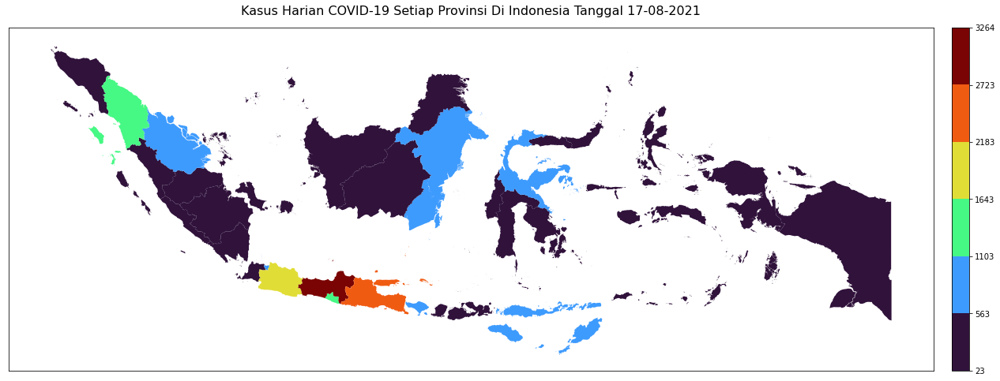

In [47]:
example_path = pathlib.Path("animation/example")
example_path.mkdir(parents=True, exist_ok=True)

save_plot(example_path, 'KASUS', '2021-08-17')
Image(open("animation/example/2021-08-17.png", 'rb').read())


## **Melakukan Visualisasi Seluruh Kasus Harian Dari Data COVID-19**

### **Inisialisasi Array Batas Tanggal Awal Dan Akhir Visualisasi**

In [48]:
date_range = [d.strftime('%Y-%m-%d') for d in pd.date_range(start, "2021-11-21")]
date_range[0:5]

['2021-05-01', '2021-05-02', '2021-05-03', '2021-05-04', '2021-05-05']

### **Inisialisasi Pembagian Provinsi Berdasarkan Zona Waktu**

In [49]:
wib = [
    'DKI Jakarta', 'Jawa Barat', 'Jawa Tengah', 'Jawa Timur', 'Bengkulu', 
    'Daerah Istimewa Yogyakarta', 'Aceh', 'Sumatera Barat', 'Sumatera Utara', 
    'Sumatera Selatan', 'Kepulauan Riau', 'Jambi', 'Riau', 'Lampung', 'Banten', 
    'Kalimantan Barat', 'Kalimantan Tengah', 'Kepulauan Bangka Belitung'  
]

wita = [
    'Bali', 'Kalimantan Utara', 'Kalimantan Timur', 'Kalimantan Selatan', 'Sulawesi Tengah', 
    'Sulawesi Barat', 'Sulawesi Tenggara', 'Sulawesi Utara', 'Sulawesi Selatan', 
    'Gorontalo', 'Nusa Tenggara Timur', 'Nusa Tenggara Barat'
]

wit = ['Maluku Utara', 'Maluku', 'Papua Barat', 'Papua']

wib = [x.upper() for x in wib]
wita = [x.upper() for x in wita]
wit = [x.upper() for x in wit]

In [50]:
animation_path = pathlib.Path("animation/")
animation_path.mkdir(parents=True, exist_ok=True)

animation_path_wib = pathlib.Path("animation/wib")
animation_path_wib.mkdir(parents=True, exist_ok=True)

animation_path_wit = pathlib.Path("animation/wit")
animation_path_wit.mkdir(parents=True, exist_ok=True)

animation_path_wita = pathlib.Path("animation/wita")
animation_path_wita.mkdir(parents=True, exist_ok=True)

In [51]:
image_files_all, image_files_wib, image_files_wita, image_files_wit = [], [], [], []

for i in tqdm(range(len(date_range))):
    image_files_all.append(save_plot(animation_path, 'KASUS', date_range[i]))
    image_files_wib.append(save_plot(animation_path_wib, 'KASUS', date_range[i], wib, 'Zona Barat'))
    image_files_wita.append(save_plot(animation_path_wita, 'KASUS', date_range[i], wita, 'Zona Tengah'))
    image_files_wit.append(save_plot(animation_path_wit, 'KASUS', date_range[i], wit, 'Zona Timur'))

100%|██████████| 205/205 [13:45<00:00,  4.03s/it]


## **Menggabungkan Frame Dan Membuat Animasi Dalam bentuk GIF** 

In [52]:
images = [imageio.imread(file_name) for file_name in image_files_all]
images_wib = [imageio.imread(file_name) for file_name in image_files_wib]
images_wita = [imageio.imread(file_name) for file_name in image_files_wita]
images_wit = [imageio.imread(file_name) for file_name in image_files_wit]

imageio.mimsave("covid_indonesia_animation.gif", images, fps=2)
imageio.mimsave("covid_indonesia_wib_animation.gif", images_wib, fps=2)
imageio.mimsave("covid_indonesia_wita_animation.gif", images_wita, fps=2)
imageio.mimsave("covid_indonesia_wit_animation.gif", images_wit, fps=2)

### **Visualisasi Seluruh Provinsi**

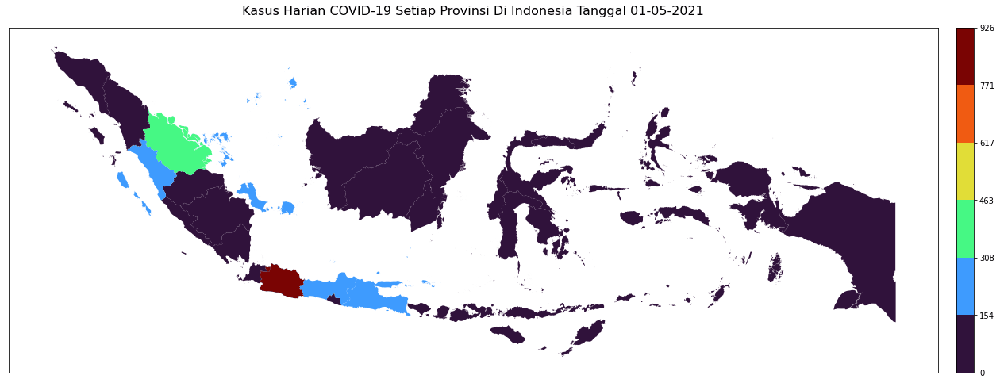

In [53]:
Image(open('covid_indonesia_animation.gif', 'rb').read())

### **Visualisasi Zona WIB**

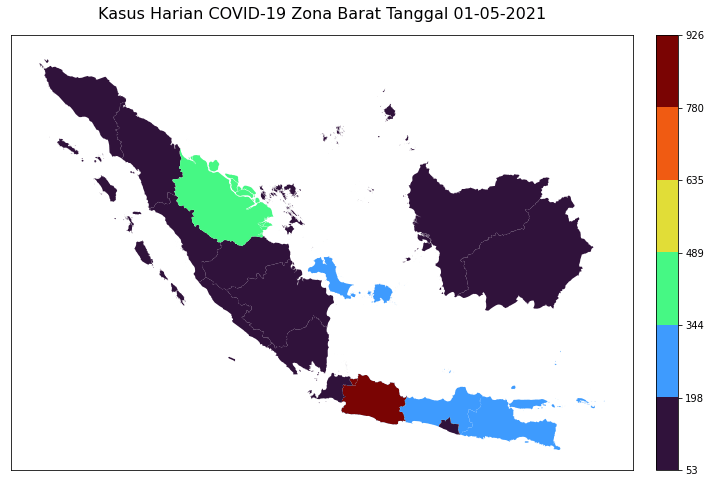

In [54]:
Image(open('covid_indonesia_wib_animation.gif','rb').read())

### **Visualisasi Zona WITA**

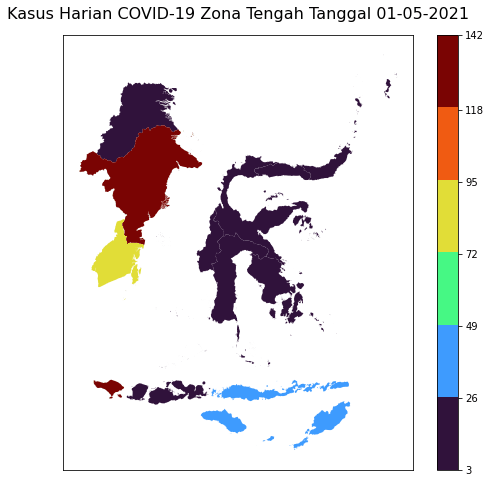

In [55]:
Image(open('covid_indonesia_wita_animation.gif','rb').read())

### **Visualisasi Zona WIT**

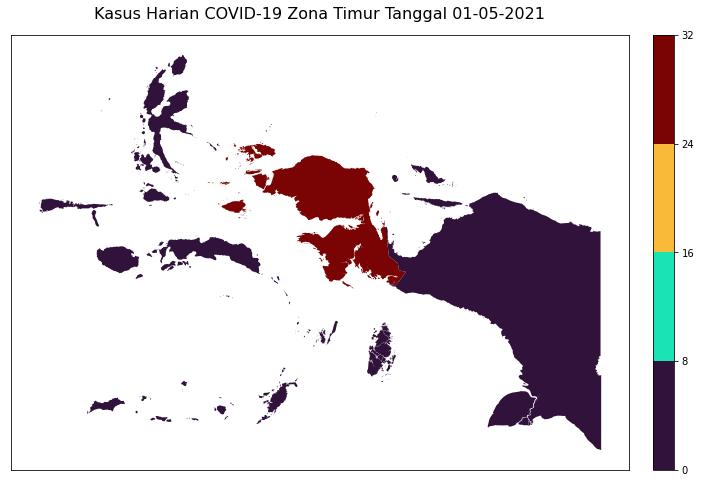

In [56]:
Image(open('covid_indonesia_wit_animation.gif','rb').read())